# First I install the necessary dependencies
I would need 'os' for interacting with the folders and file in the project, 'numpy' for mathematical expression and operations, 'matplotlib' to show images, and 'OpenCV' for computer vision operations like filtering and morphological operations.

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import hough_ellipse
from skimage.draw import ellipse_perimeter
from skimage.morphology import thin
from skimage.util import invert

# Then I load the images using os and OpenCV

In [2]:
def get_image_paths(folder_path):
    # Create a list to store the paths
    image_paths=[]
    # List all files in the folder
    for filename in os.listdir(folder_path):
        # Check if the file is an image (common image extensions)
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            # Create full image path
            file_path = os.path.join(folder_path, filename)
            # Append the path to the list of paths
            image_paths.append(file_path)
    return image_paths
         
image_paths=get_image_paths('images')
print(image_paths)
# Path to the test image
image_path = 'images/photo_2024-12-10_19-00-54.jpg'  
image = cv2.imread(image_path)
height, width = image.shape[:2]
print(f"Image dimensions: {width}x{height}")
if image is None:
    raise ValueError(f"Could not read image from {image_path}")

""" image_path = 'ellipse.png'  
image = cv2.imread(image_path) """

['images\\photo_2024-12-10_19-00-02.jpg', 'images\\photo_2024-12-10_19-00-54.jpg', 'images\\photo_2024-12-10_19-01-46.jpg', 'images\\photo_2024-12-10_19-02-39.jpg', 'images\\photo_2024-12-10_19-03-29.jpg', 'images\\photo_2024-12-10_19-30-04.jpg', 'images\\photo_2024-12-10_19-30-05.jpg', 'images\\photo_2024-12-10_19-30-06.jpg', 'images\\photo_2024-12-10_19-30-12.jpg', 'images\\photo_2024-12-10_19-30-13.jpg', 'images\\photo_2024-12-10_19-30-14.jpg', 'images\\photo_2024-12-10_19-30-19.jpg', 'images\\photo_2024-12-10_19-30-20.jpg', 'images\\photo_2024-12-10_19-30-21.jpg', 'images\\photo_2024-12-10_19-30-24.jpg', 'images\\photo_2024-12-10_19-30-26.jpg', 'images\\photo_2024-12-10_19-30-27.jpg', 'images\\photo_2024-12-10_19-30-29.jpg', 'images\\photo_2024-12-10_19-30-38.jpg', 'images\\photo_2024-12-10_19-30-39.jpg', 'images\\photo_2024-12-10_19-30-40.jpg', 'images\\photo_2024-12-10_19-30-41.jpg', 'images\\photo_2024-12-10_19-30-42.jpg']
Image dimensions: 1280x960


" image_path = 'ellipse.png'  \nimage = cv2.imread(image_path) "

# 1\) Edge detection
This step is paramount for most kind of image processing, because it basically allows the computer to understand the shape of an object.
The way i perform it can be synthesized in 4 steps:
- Convert the image in LAB representation \(\(LAB color space represents colors in a way that is more perceptually uniform to human vision, separating lightness (L) from color components (A for green-red and B for blue-yellow)
- Perform edge detection using Otsu's threshold and Canny edge detection on the L channel
- Apply a mask to the A channel in order to retain only the pixel with a value over 75% of the maximum A value
- Apply a bitwise AND between the two images in order to keep the kiwi borders but reject the leaf borders
- Fill the kiwi shapes and remove the background.

The threshold for the Canny edge detector is calculated with the Otsu algorithm, which calculates the ideal threshold for each image, this has been done to avoid different beahviour to different saturation levels.
I found out that the gaussian blur was essential to reduce noise before edge detection, as without the noise made it impossible to have a clear round figure

In [3]:
# Convert to RGB for matplotlib
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert to LAB color space
lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
L, A, B = cv2.split(lab)

# Normalize the L, A, B channels for better visualization
L = cv2.normalize(L, None, 0, 255, cv2.NORM_MINMAX)
A = cv2.normalize(A, None, 0, 255, cv2.NORM_MINMAX)
B = cv2.normalize(B, None, 0, 255, cv2.NORM_MINMAX)

For the image of the L channel i first, then detect the edges using Canny edge detection, using a threshold found using the Otsu's algorithm.

In [4]:
# Apply Gaussian blur on L channel
L_blurred = cv2.GaussianBlur(L, (5, 5), 0)
# Apply Otsu's thresholding on L channel
L_thresh, _ = cv2.threshold(L_blurred, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
# Apply Canny edge detection using Otsu's threshold
L_edges = cv2.Canny(L_blurred, L_thresh/2, L_thresh)
# Vertical-focused dilation kernel (taller than wide)
L_dilation_kernel = np.ones((7, 7), np.uint8)  # 7 rows, 3 columns
# Dilate to connect edge fragments
L_dilated = cv2.dilate(L_edges, L_dilation_kernel, iterations=1)

LAB image edge detection using A channel and Otsu'threshold

In [15]:
# Apply Gaussian blur on A channel
A_blurred = cv2.GaussianBlur(A, (37, 37), 0)
# Apply binary thresholding on A channel
otsu_thresh, _ = cv2.threshold(A_blurred, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
custom_thresh = otsu_thresh * 1.1
_, A_masked = cv2.threshold(A_blurred, custom_thresh, 255, cv2.THRESH_BINARY)
# Apply median filter to remove noise
A_median = cv2.medianBlur(A_masked, 49)
# Perform bitswise AND operation to combine the edges from L and A channels
common_edges = cv2.bitwise_and(L_dilated, A_median)
# Apply closing to fill gaps in the edges
closed_edges = cv2.morphologyEx(common_edges, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))


""" image_path = 'ellipse.png'  
image = cv2.imread(image_path)
closed_edges = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
closed_edges = invert(closed_edges) """


# Function to resize the image while maintaining aspect ratio
def resize_adaptive(img, short_side_target=120):
    h, w = img.shape[:2]
    if w < h:
        # Portrait → make width = 120
        scale = short_side_target / w
    else:
        # Landscape → make height = 120
        scale = short_side_target / h

    new_w = int(round(w * scale))
    new_h = int(round(h * scale))

    resized = cv2.resize(img, (new_w, new_h), interpolation=cv2.INTER_AREA)
    return resized
# Resize the image to a smaller size for faster processing
ce_small = resize_adaptive(closed_edges, short_side_target=120)
# Apply Otsu's thresholding on the resized image
_, ce_small_bin = cv2.threshold(ce_small, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
# Thinning the edges to a single pixel width
ce_thinned = thin(ce_small_bin // 255)
# Converti in uint8 (0-255)
ce_thinned = (ce_thinned * 255).astype(np.uint8)

ellipse_mask = np.zeros_like(ce_thinned)

# --- Add these checks BEFORE calling hough_ellipse ---
print(f"Shape of image_small: {ce_thinned.shape}")
print(f"Data type of image_small: {ce_thinned.dtype}")
print(f"Min pixel value in image_small: {np.min(ce_thinned)}")
print(f"Max pixel value in image_small: {np.max(ce_thinned)}")
print(f"Unique pixel values in image_small: {np.unique(ce_thinned)}")

Shape of image_small: (120, 160)
Data type of image_small: uint8
Min pixel value in image_small: 0
Max pixel value in image_small: 255
Unique pixel values in image_small: [  0 255]


In [16]:
# Run Hough Ellipse Transform
result = hough_ellipse(
    ce_thinned,
    threshold=25,      # filter weak/noisy edges
    accuracy=1,        # better precision
    min_size=20,        # ignore small noise
    max_size=120        # ignore absurdly large shapes
)
result.sort(order='accumulator')  # Sort by confidence

# Draw the best detected ellipse
if len(result) > 0:
    best = result[-1]  # Highest accumulator value
    yc, xc, a, b, theta = best[1], best[2], best[3], best[4], best[5]
    if a > 0 and b > 0:
        cy, cx = ellipse_perimeter(int(yc), int(xc), int(a), int(b), theta)

        # Validate points
        valid = (cy >= 0) & (cy < ellipse_mask.shape[0]) & (cx >= 0) & (cx < ellipse_mask.shape[1])
        ellipse_mask[cy[valid], cx[valid]] = 255

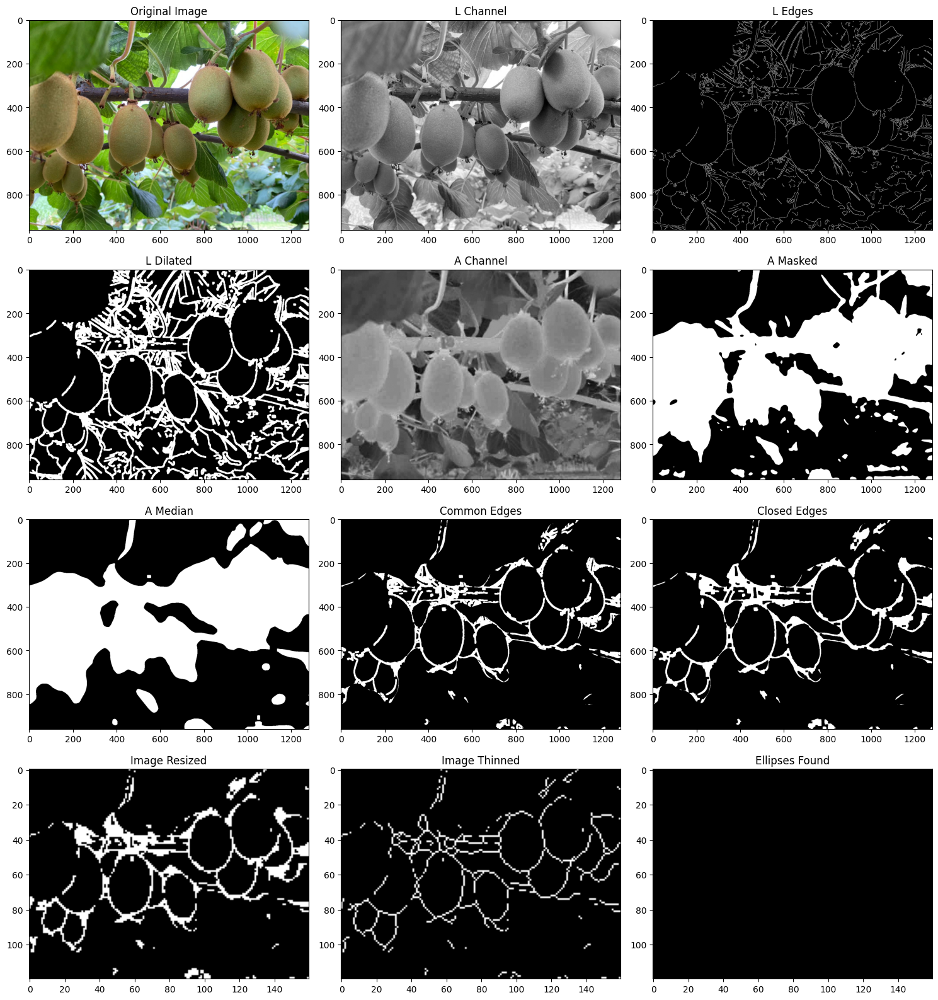

In [17]:
# Visualize all channels
plt.figure(figsize=(15, 16))

plt.subplot(4, 3, 1)
plt.title('Original Image')
plt.imshow(image_rgb)

plt.subplot(4, 3, 2)
plt.title('L Channel')
plt.imshow(L, cmap='gray')

plt.subplot(4, 3, 3)
plt.title('L Edges')
plt.imshow(L_edges, cmap='gray')

plt.subplot(4, 3, 4)
plt.title('L Dilated')
plt.imshow(L_dilated, cmap='gray')

plt.subplot(4, 3, 5)
plt.title('A Channel')
plt.imshow(A, cmap='gray')

plt.subplot(4, 3, 6)
plt.title('A Masked')
plt.imshow(A_masked, cmap='gray')

plt.subplot(4, 3, 7)
plt.title('A Median')
plt.imshow(A_median, cmap='gray')

plt.subplot(4, 3, 8)
plt.title('Common Edges')
plt.imshow(common_edges, cmap='gray')

plt.subplot(4, 3, 9)
plt.title("Closed Edges")
plt.imshow(closed_edges, cmap='gray')

plt.subplot(4, 3, 10)
plt.title("Image Resized")
plt.imshow(ce_small_bin, cmap='gray')

plt.subplot(4, 3, 11)
plt.title("Image Thinned")
plt.imshow(ce_thinned, cmap='gray')

plt.subplot(4, 3, 12)
plt.title("Ellipses Found")
plt.imshow(ellipse_mask, cmap='gray')

plt.tight_layout()
plt.savefig('./edge_detection_experiments/max_blur7.png')
plt.show()

# Pipeline to process the entire dataset for testing

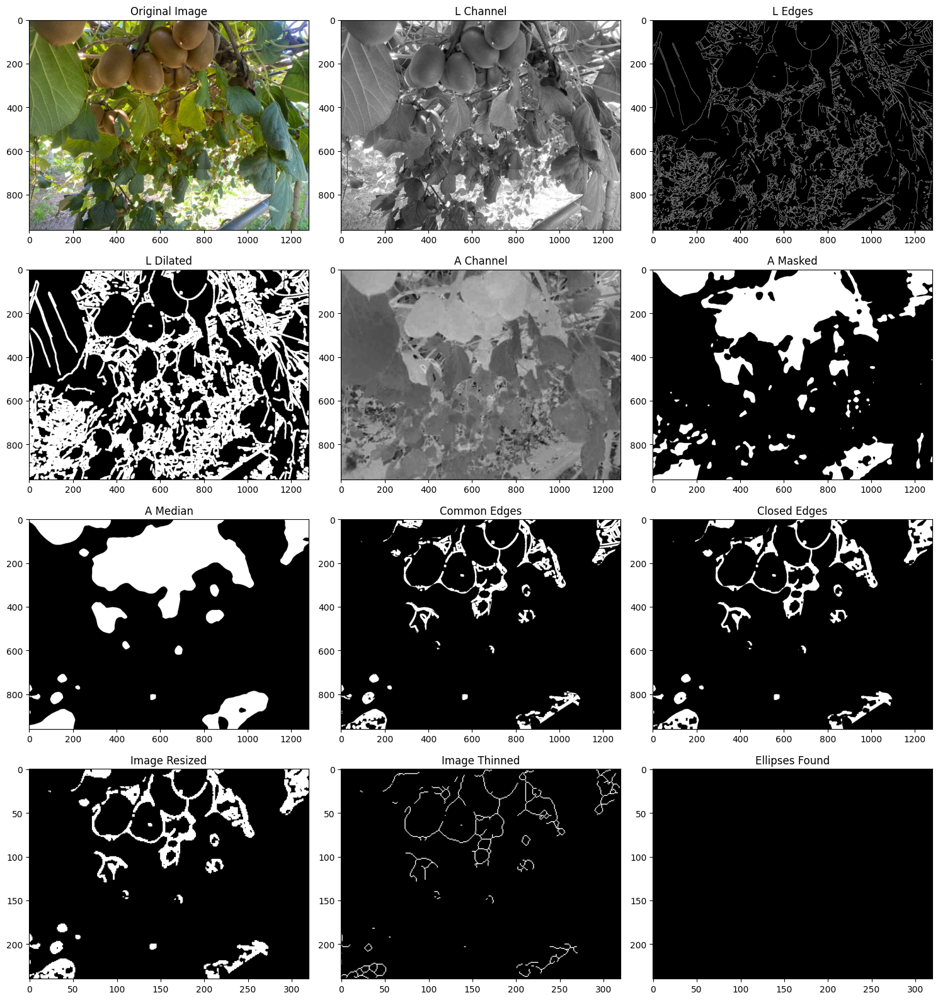

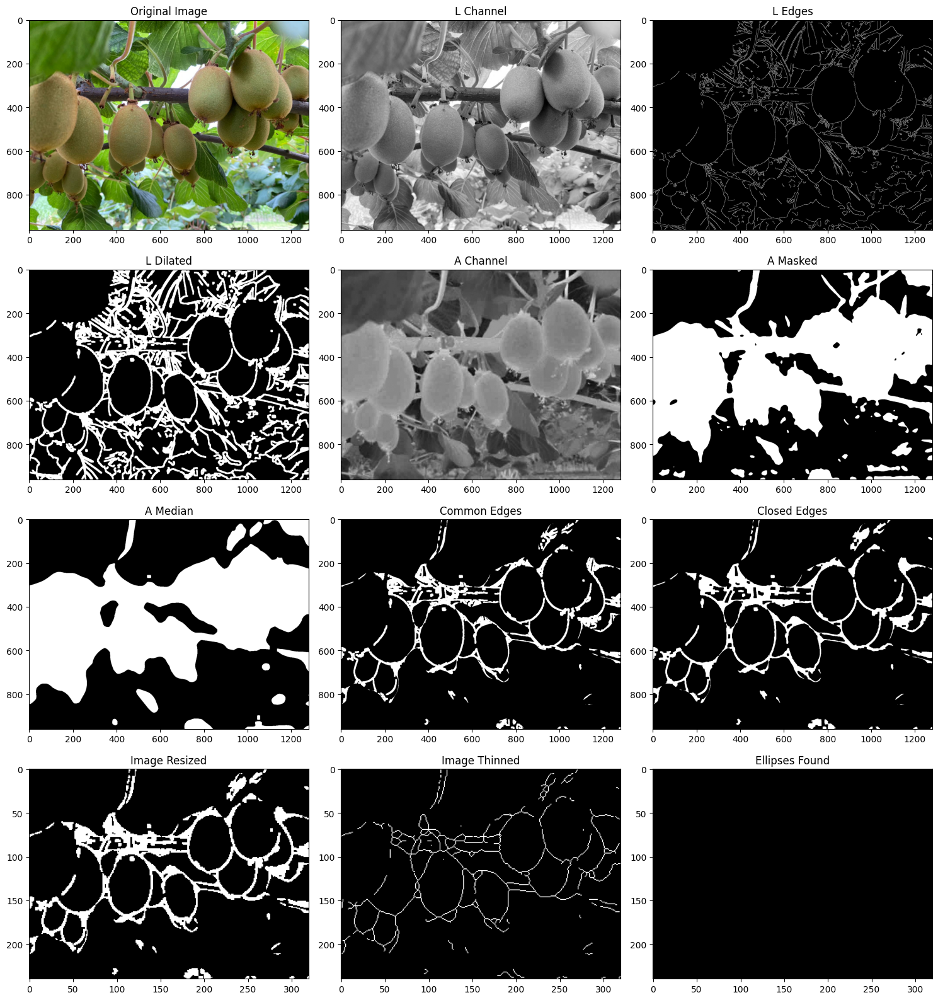

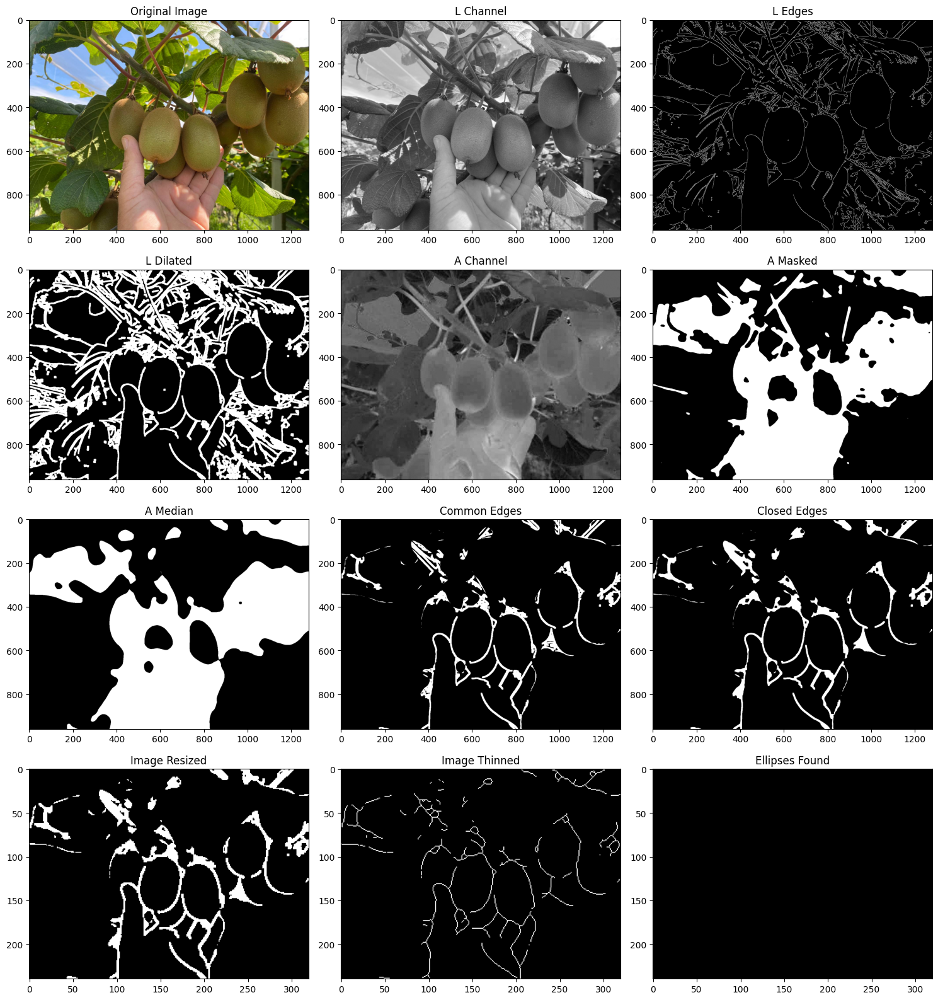

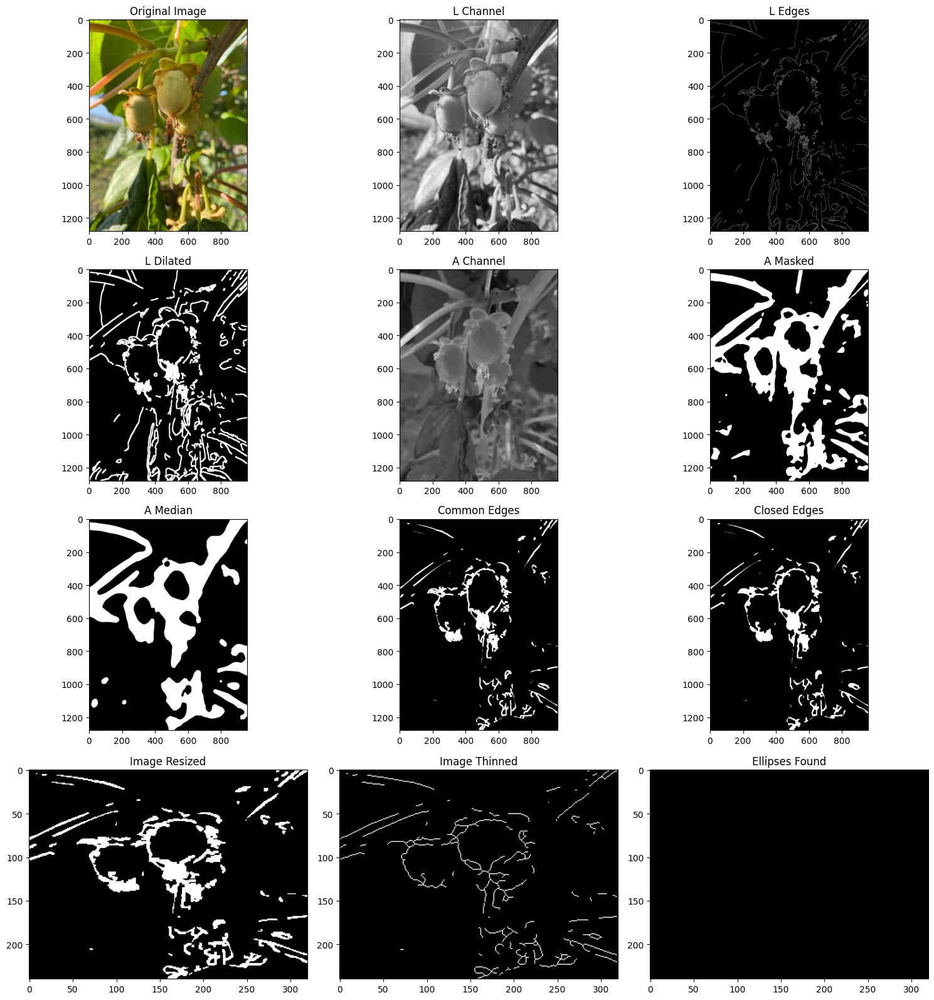

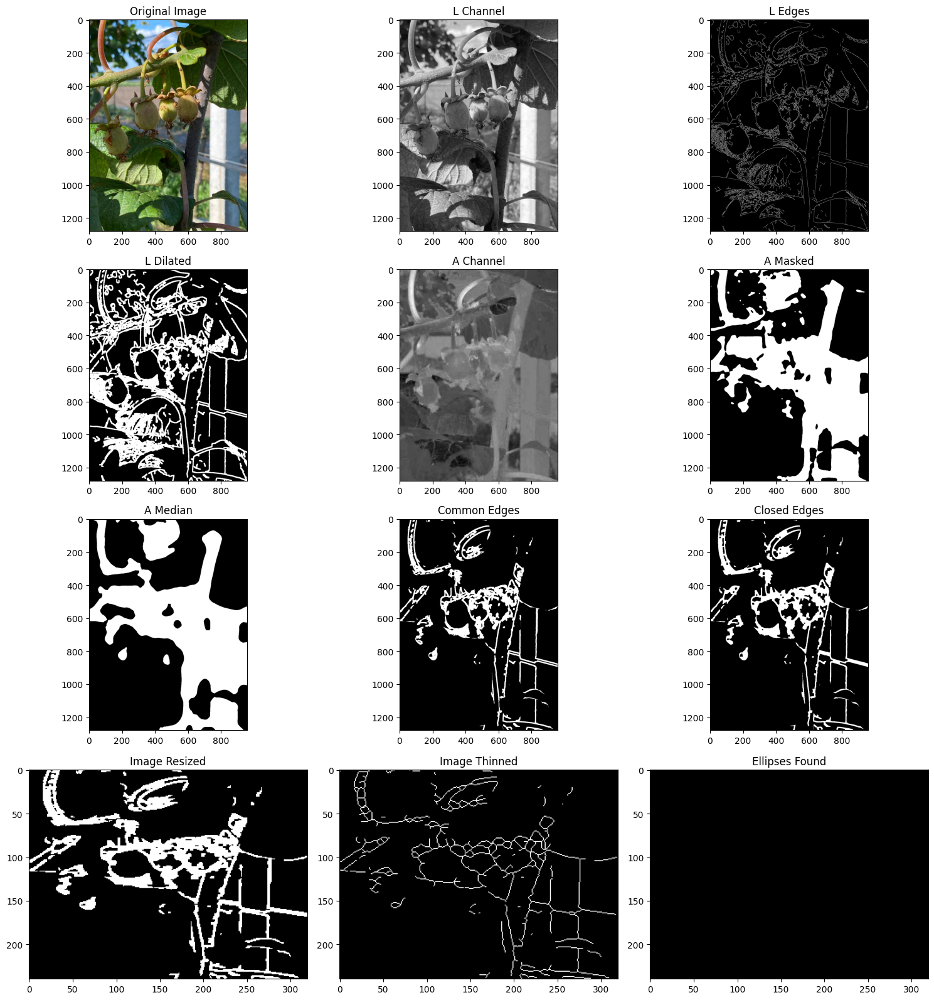

...

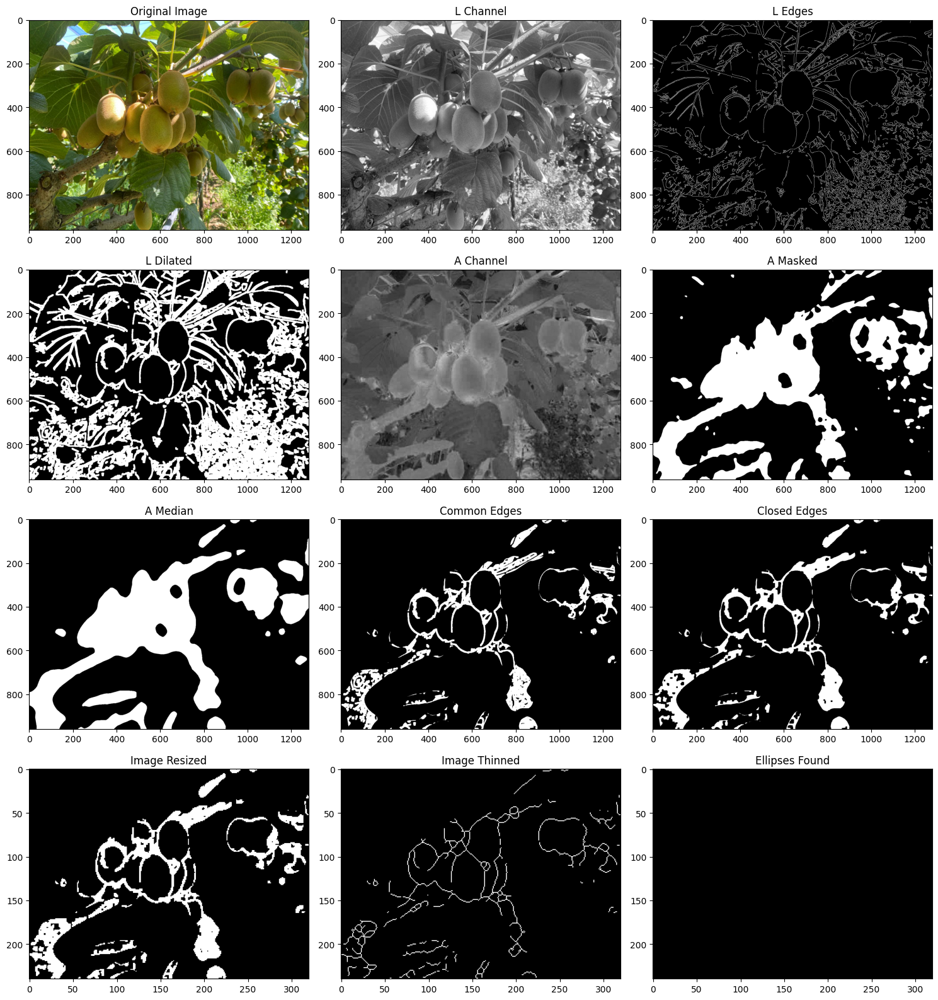

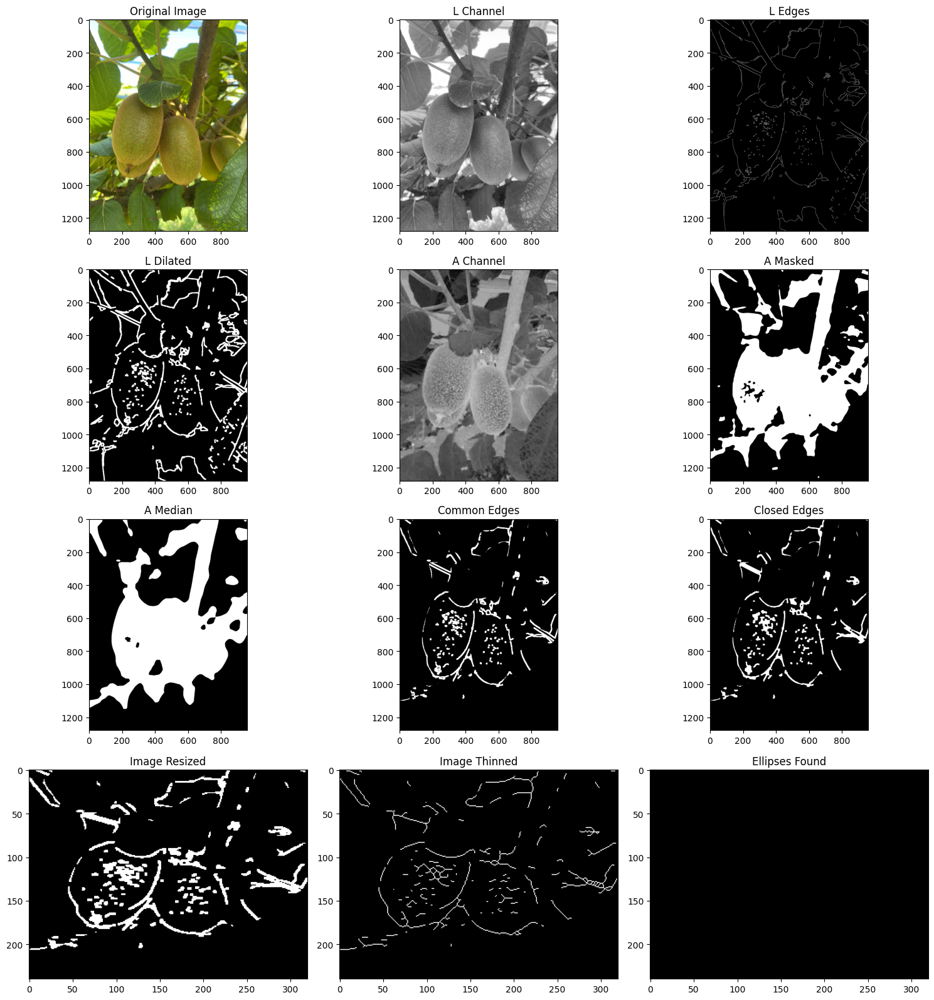

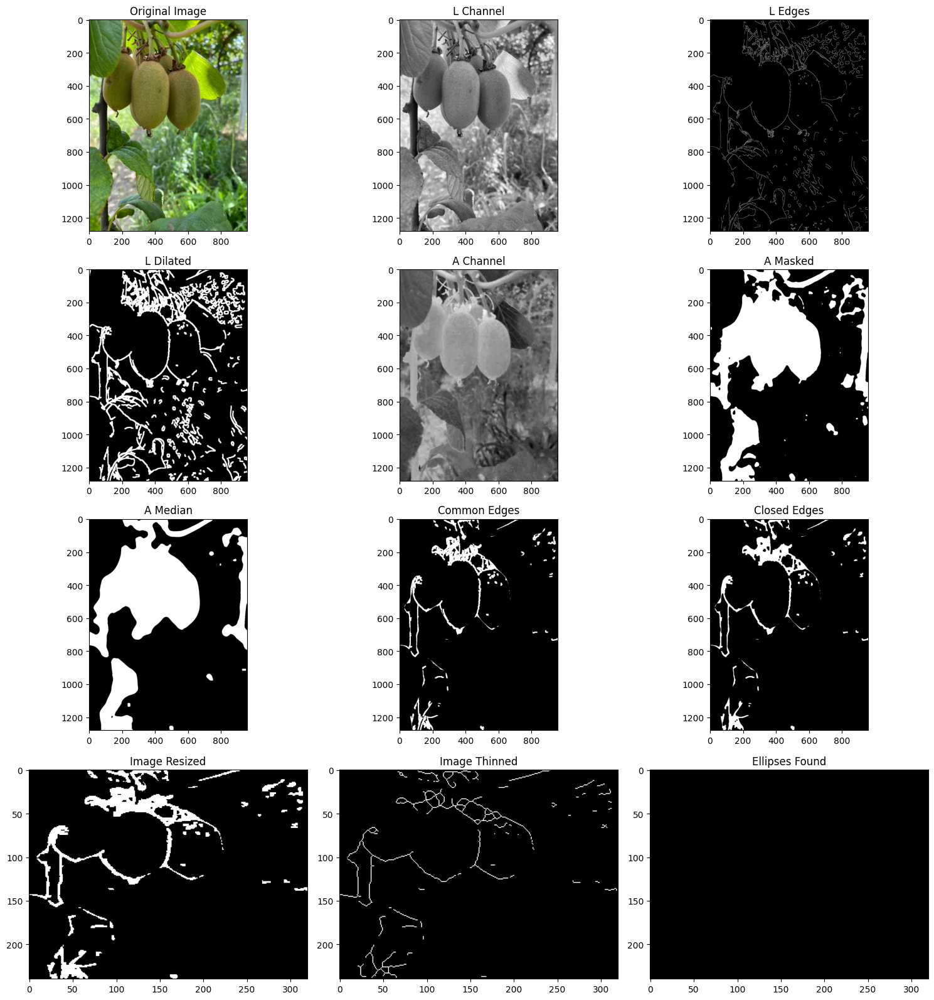

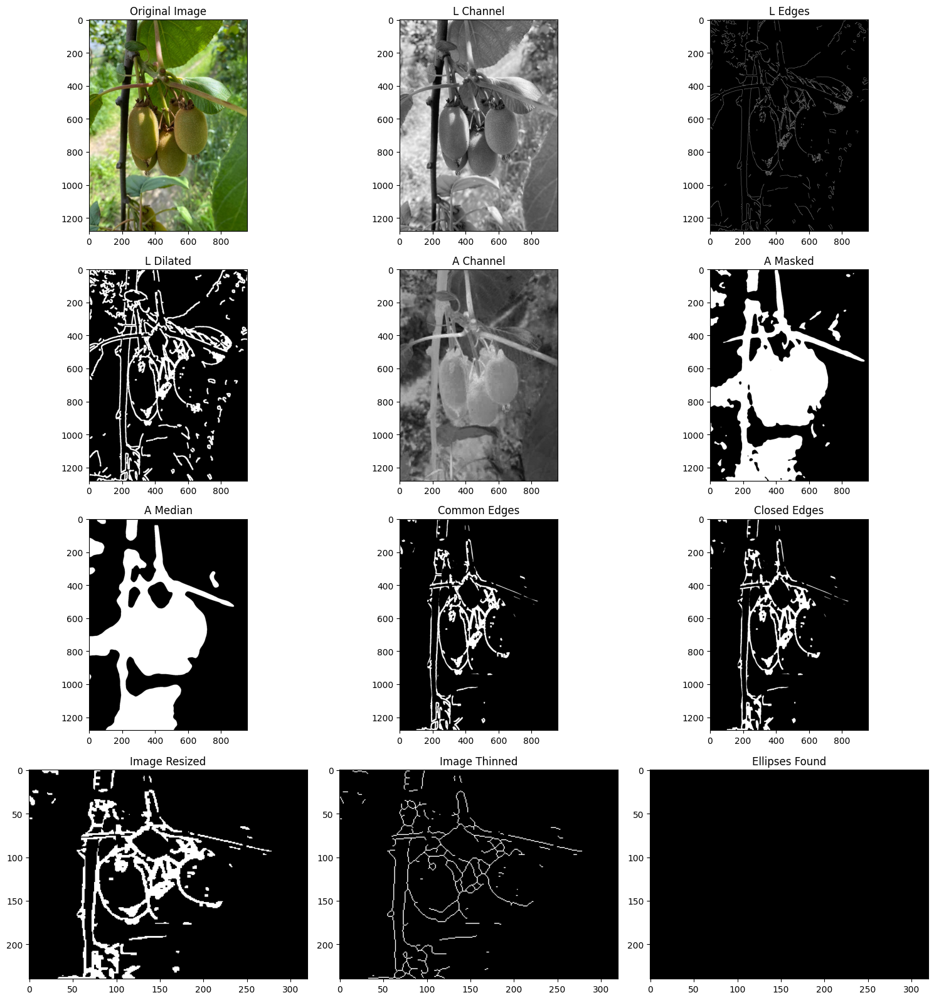

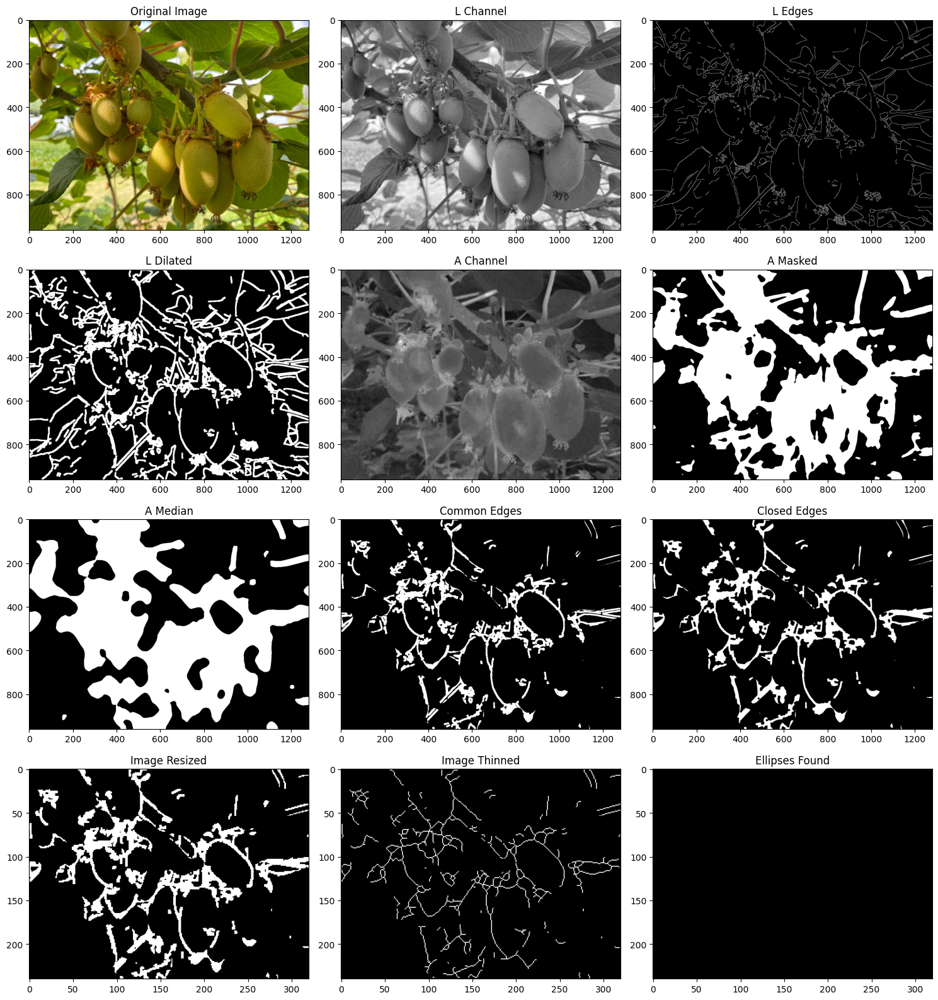

In [180]:
for image_path in image_paths:

    # Read the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Could not read image from {image_path}")

    # Convert to RGB for matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Convert to LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    L, A, B = cv2.split(lab)

    # Normalize the L, A, B channels for better visualization
    L = cv2.normalize(L, None, 0, 255, cv2.NORM_MINMAX)
    A = cv2.normalize(A, None, 0, 255, cv2.NORM_MINMAX)
    B = cv2.normalize(B, None, 0, 255, cv2.NORM_MINMAX)

    # --------------------------------------------------------------------------------

    # Apply Gaussian blur on L channel
    L_blurred = cv2.GaussianBlur(L, (5, 5), 0)
    # Apply Otsu's thresholding on L channel
    L_thresh, _ = cv2.threshold(L_blurred, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    # Apply Canny edge detection using Otsu's threshold
    L_edges = cv2.Canny(L_blurred, L_thresh/2, L_thresh)
    # Vertical-focused dilation kernel (taller than wide)
    L_dilation_kernel = np.ones((7, 7), np.uint8)  # 7 rows, 3 columns
    # Dilate to connect edge fragments
    L_dilated = cv2.dilate(L_edges, L_dilation_kernel, iterations=1)

    # --------------------------------------------------------------------------------

    # Apply Gaussian blur on A channel
    A_blurred = cv2.GaussianBlur(A, (37, 37), 0)
    # Apply binary thresholding on A channel
    otsu_thresh, _ = cv2.threshold(A_blurred, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    custom_thresh = otsu_thresh * 1.1
    _, A_masked = cv2.threshold(A_blurred, custom_thresh, 255, cv2.THRESH_BINARY)
    # Apply median filter to remove noise
    A_median = cv2.medianBlur(A_masked, 49)
    # Perform bitswise AND operation to combine the edges from L and A channels
    common_edges = cv2.bitwise_and(L_dilated, A_median)
    # Apply closing to fill gaps in the edges
    closed_edges = cv2.morphologyEx(common_edges, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))
    # Resize the image to a smaller size for faster processing
    ce_small = cv2.resize(closed_edges, (320, 240), interpolation=cv2.INTER_AREA)
    # Apply Otsu's thresholding on the resized image
    _, ce_small_bin = cv2.threshold(ce_small, 0, 255, cv2.THRESH_BINARY)
    # Thinning the edges to a single pixel width
    ce_thinned = thin(ce_small_bin)
    # Converti in uint8 (0-255)
    ce_thinned = (ce_thinned * 255).astype(np.uint8)

    ellipse_mask = np.zeros_like(ce_thinned)

    # --------------------------------------------------------------------------------

    # Visualize all channels
    plt.figure(figsize=(15, 16))

    plt.subplot(4, 3, 1)
    plt.title('Original Image')
    plt.imshow(image_rgb)

    plt.subplot(4, 3, 2)
    plt.title('L Channel')
    plt.imshow(L, cmap='gray')

    plt.subplot(4, 3, 3)
    plt.title('L Edges')
    plt.imshow(L_edges, cmap='gray')

    plt.subplot(4, 3, 4)
    plt.title('L Dilated')
    plt.imshow(L_dilated, cmap='gray')

    plt.subplot(4, 3, 5)
    plt.title('A Channel')
    plt.imshow(A, cmap='gray')

    plt.subplot(4, 3, 6)
    plt.title('A Masked')
    plt.imshow(A_masked, cmap='gray')

    plt.subplot(4, 3, 7)
    plt.title('A Median')
    plt.imshow(A_median, cmap='gray')

    plt.subplot(4, 3, 8)
    plt.title('Common Edges')
    plt.imshow(common_edges, cmap='gray')

    plt.subplot(4, 3, 9)
    plt.title("Closed Edges")
    plt.imshow(closed_edges, cmap='gray')

    plt.subplot(4, 3, 10)
    plt.title("Image Resized")
    plt.imshow(ce_small_bin, cmap='gray')

    plt.subplot(4, 3, 11)
    plt.title("Image Thinned")
    plt.imshow(ce_thinned, cmap='gray')

    plt.subplot(4, 3, 12)
    plt.title("Ellipses Found")
    plt.imshow(ellipse_mask, cmap='gray')

    plt.tight_layout()
    plt.savefig('./edge_detection_experiments/LGaussian5x5-AGaussian37x37-AOtsux1_1-AMasked49/'+image_path.split('\\')[1].split('.')[0]+'.jpg')
    plt.show()